In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
TRAIN_DIR = "/content/drive/MyDrive/fish_project1/dataset/train"
VAL_DIR   = "/content/drive/MyDrive/fish_project1/dataset/val"
TEST_DIR  = "/content/drive/MyDrive/fish_project1/dataset/test"


In [ ]:
!pip install tensorflow matplotlib scikit-learn


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

IMG_SIZE = (224, 224)
BATCH_SIZE = 16

train_gen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    zoom_range=0.2,
    horizontal_flip=True
)

val_gen = ImageDataGenerator(rescale=1./255)

train_data = train_gen.flow_from_directory(
    TRAIN_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical'
)

val_data = val_gen.flow_from_directory(
    VAL_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical'
)


Found 8717 images belonging to 5 classes.
Found 1256 images belonging to 5 classes.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model

base_model = MobileNetV2(
    input_shape=(224,224,3),
    include_top=False,
    weights='imagenet'
)

base_model.trainable = False

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
output = Dense(train_data.num_classes, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=output)


9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
model.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy']
)


In [ ]:
EPOCHS = 15

history = model.fit(
    train_data,
    validation_data=val_data,
    epochs=EPOCHS
)


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 3915s 7s/step - accuracy: 0.7076 - loss: 0.6353 - val_accuracy: 0.7795 - val_loss: 0.4629
Epoch 2/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 140s 257ms/step - accuracy: 0.7998 - loss: 0.4475 - val_accuracy: 0.7890 - val_loss: 0.4409
Epoch 3/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 143s 262ms/step - accuracy: 0.8181 - loss: 0.3994 - val_accuracy: 0.8432 - val_loss: 0.3558
Epoch 4/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 142s 261ms/step - accuracy: 0.8308 - loss: 0.3748 - val_accuracy: 0.8678 - val_loss: 0.3196
Epoch 5/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 143s 263ms/step - accuracy: 0.8373 - loss: 0.3575 - val_accuracy: 0.8416 - val_loss: 0.3715
Epoch 6/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 141s 259ms/step - accuracy: 0.8508 - loss: 0.3326 - val_accuracy: 0.8575 - val_loss: 0.3116
Epoch 7/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 140s 256ms/step - accuracy: 0.8662 - loss: 0.3014 - val_accuracy: 0.8678 - val_loss: 0.3032
Epoch 8/15
545/545 ━━━━━━━━━━━━━━━━━━━━ 141s 258ms/step - accuracy: 0.8744 - l

In [ ]:
model.save("/content/drive/MyDrive/fish_project1/best_fish_model.h5")


In [ ]:
test_gen = ImageDataGenerator(rescale=1./255)

test_data = test_gen.flow_from_directory(
    TEST_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

model.evaluate(test_data)


Found 1533 images belonging to 5 classes.
96/96 ━━━━━━━━━━━━━━━━━━━━ 433s 5s/step - accuracy: 0.9395 - loss: 0.1616


[0.2113691121339798, 0.9217221140861511]

In [ ]:
!pip install opencv-python tensorflow numpy


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
MODEL_PATH = "/content/drive/MyDrive/fish_project1/best_fish_model.h5"
VIDEO_PATH = "/content/drive/MyDrive/fish_project1/input_video.mp4"
OUTPUT_PATH = "/content/drive/MyDrive/fish_project1/classified_output.mp4"


In [ ]:
import tensorflow as tf

model = tf.keras.models.load_model(MODEL_PATH)
print("✅ Model loaded successfully")


✅ Model loaded successfully


In [ ]:
CLASS_NAMES = ['Ribbonfish', 'animal fish', 'animal fish bass', 'bleached_corals', 'healthy_corals']  # example
label = f"{CLASS_NAMES[class_id]} | {confidence:.2f}%"


NameError: name 'class_id' is not defined

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

TEST_DIR = "/content/drive/MyDrive/fish_project1/dataset/test"

test_datagen = ImageDataGenerator(rescale=1./255)

test_data = test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)


Found 1533 images belonging to 5 classes.


In [ ]:
loss, accuracy = model.evaluate(test_data)

print(f"✅ Test Accuracy: {accuracy * 100:.2f}%")
print(f"✅ Test Loss: {loss:.4f}")


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


48/48 ━━━━━━━━━━━━━━━━━━━━ 32s 403ms/step - accuracy: 0.9390 - loss: 0.1633
✅ Test Accuracy: 92.17%
✅ Test Loss: 0.2114


In [ ]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Predictions
preds = model.predict(test_data)
y_pred = np.argmax(preds, axis=1)
y_true = test_data.classes

# Report
print(classification_report(
    y_true,
    y_pred,
    target_names=test_data.class_indices.keys()
))

# Confusion Matrix
cm = confusion_matrix(y_true, y_pred)
print("Confusion Matrix:\n", cm)


48/48 ━━━━━━━━━━━━━━━━━━━━ 18s 243ms/step
                  precision    recall  f1-score   support

      Ribbonfish       1.00      1.00      1.00        77
     animal fish       0.98      0.95      0.96       520
animal fish bass       0.82      0.69      0.75        13
 bleached_corals       0.93      0.86      0.90       485
  healthy_corals       0.84      0.95      0.89       438

        accuracy                           0.92      1533
       macro avg       0.91      0.89      0.90      1533
    weighted avg       0.92      0.92      0.92      1533

Confusion Matrix:
 [[ 77   0   0   0   0]
 [  0 494   1   7  18]
 [  0   4   9   0   0]
 [  0   7   1 419  58]
 [  0   0   0  24 414]]


In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

test_datagen = ImageDataGenerator(rescale=1./255)

test_data = test_datagen.flow_from_directory(
    TEST_DIR,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 1533 images belonging to 5 classes.


In [ ]:
CLASS_NAMES = list(test_data.class_indices.keys())
print("Class order:", CLASS_NAMES)


Class order: ['Ribbonfish', 'animal fish', 'animal fish bass', 'bleached_corals', 'healthy_corals']


In [ ]:
# Base project directory in Google Drive
BASE_DIR = "/content/drive/MyDrive/fish_project1"

# Paths
VIDEO_PATH = f"{BASE_DIR}/input_video.mp4"
OUTPUT_VIDEO_PATH = f"{BASE_DIR}/classified_output.mp4"
MODEL_PATH = f"{BASE_DIR}/best_fish_model.h5"


In [ ]:
import cv2
import numpy as np
from collections import deque

cap = cv2.VideoCapture(VIDEO_PATH)

if not cap.isOpened():
    raise IOError("❌ Cannot open input video")

fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

fourcc = cv2.VideoWriter_fourcc(*"mp4v")
out = cv2.VideoWriter(OUTPUT_VIDEO_PATH, fourcc, fps, (width, height))

IMG_SIZE = 224
pred_buffer = deque(maxlen=15)
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    img = cv2.resize(frame, (IMG_SIZE, IMG_SIZE))
    img = img / 255.0
    img = np.expand_dims(img, axis=0)

    preds = model.predict(img, verbose=0)
    class_id = np.argmax(preds)
    confidence = np.max(preds) * 100

    pred_buffer.append(class_id)
    class_id = max(set(pred_buffer), key=pred_buffer.count)

    label = f"{CLASS_NAMES[class_id]} | {confidence:.1f}%"

    # Draw background
    (tw, th), _ = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 1.2, 3)
    cv2.rectangle(frame, (15, 10), (15+tw+10, 60), (0,0,0), -1)

    # Draw text
    cv2.putText(frame, label, (20, 50),
                cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0,255,0), 3)

    out.write(frame)

cap.release()
out.release()
cv2.destroyAllWindows()

print(f"✅ Video classified successfully")
print(f"🎥 Frames processed: {frame_count}")
print(f"📁 Saved to: {OUTPUT_VIDEO_PATH}")


✅ Video classified successfully
🎥 Frames processed: 608
📁 Saved to: /content/drive/MyDrive/fish_project1/classified_output.mp4


In [ ]:
from google.colab import files

uploaded = files.upload()


Saving fish_2394.jpg to fish_2394.jpg


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# get uploaded image path
image_path = list(uploaded.keys())[0]

IMG_SIZE = 224

# read image
img = cv2.imread(image_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# resize & normalize
img_resized = cv2.resize(img, (IMG_SIZE, IMG_SIZE))
img_norm = img_resized / 255.0
img_input = np.expand_dims(img_norm, axis=0)

# predict
preds = model.predict(img_input)
class_id = np.argmax(preds)
confidence = np.max(preds) * 100

print("Raw prediction:", preds)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
Raw prediction: [[9.9999905e-01 9.7014117e-07 3.8870591e-09 5.6220567e-10 2.0925321e-09]]


In [ ]:
# Load from test folder (recommended)
from tensorflow.keras.preprocessing.image import ImageDataGenerator

TEST_DIR = "/content/drive/MyDrive/fish_project1/dataset/test"

test_gen = ImageDataGenerator(rescale=1./255)

test_data = test_gen.flow_from_directory(
    TEST_DIR,
    target_size=(224, 224),
    batch_size=1,
    class_mode='categorical'
)

CLASS_NAMES = list(test_data.class_indices.keys())
print("Class names:", CLASS_NAMES)


Found 1533 images belonging to 5 classes.
Class names: ['Ribbonfish', 'animal fish', 'animal fish bass', 'bleached_corals', 'healthy_corals']


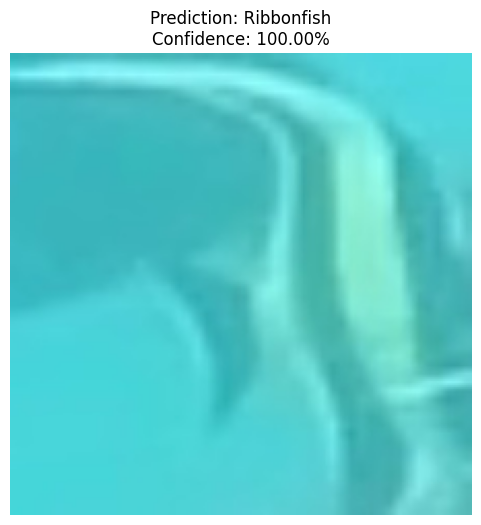

In [ ]:
predicted_class = CLASS_NAMES[class_id]

plt.figure(figsize=(6,6))
plt.imshow(img)
plt.axis("off")
plt.title(f"Prediction: {predicted_class}\nConfidence: {confidence:.2f}%")
plt.show()


In [ ]:
!pip install ultralytics supervision opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 36.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 212.4/212.4 kB 24.8 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os

# Input video (raw, NOT annotated)
VIDEO_PATH = "/content/drive/MyDrive/fish_project1/input_video.mp4"

# Trained model
MODEL_PATH = "/content/drive/MyDrive/fish_project1/best_fish_model.h5"

# Output directory & file
OUTPUT_DIR = "/content/drive/MyDrive/fish_project1/output"
os.makedirs(OUTPUT_DIR, exist_ok=True)

OUTPUT_VIDEO_PATH = OUTPUT_DIR + "/classified_output.mp4"

print("Video exists:", os.path.exists(VIDEO_PATH))
print("Model exists:", os.path.exists(MODEL_PATH))
print("Output dir exists:", os.path.exists(OUTPUT_DIR))


Video exists: True
Model exists: True
Output dir exists: True


In [ ]:
import tensorflow as tf

CLASS_NAMES = ['Ribbonfish', 'animal fish', 'animal fish bass', 'bleached_corals', 'healthy_corals']
model = tf.keras.models.load_model(MODEL_PATH)
print("✅ Model loaded")


✅ Model loaded


In [ ]:
import cv2
import os
import numpy as np

TEMP_OUTPUT_PATH = "/content/classified_output.mp4"

fourcc = cv2.VideoWriter_fourcc(*"mp4v")  # MOST COMPATIBLE
out = cv2.VideoWriter(
    TEMP_OUTPUT_PATH,
    fourcc,
    int(fps),
    (int(width), int(height))
)

if not out.isOpened():
    raise RuntimeError("❌ VideoWriter failed even in /content")

print("✅ VideoWriter opened successfully (local)")


✅ VideoWriter opened successfully (local)


In [ ]:
IMG_SIZE = 224
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    img = cv2.resize(frame, (IMG_SIZE, IMG_SIZE))
    img = img / 255.0
    img = np.expand_dims(img, axis=0)

    preds = model.predict(img, verbose=0)
    class_id = np.argmax(preds)
    confidence = np.max(preds) * 100

    label = f"{CLASS_NAMES[class_id]} | {confidence:.1f}%"

    cv2.rectangle(frame, (10, 10), (600, 60), (0, 0, 0), -1)
    cv2.putText(frame, label, (20, 50),
                cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), 3)

    out.write(frame)

cap.release()
out.release()
cv2.destroyAllWindows()

print("✅ Video processing completed")
print("Frames processed:", frame_count)


✅ Video processing completed
Frames processed: 0


In [ ]:
import shutil

FINAL_OUTPUT_PATH = "/content/drive/MyDrive/fish_project1/output/classified_output.mp4"
shutil.copy(TEMP_OUTPUT_PATH, FINAL_OUTPUT_PATH)

print("✅ Video copied to Google Drive")
print("📁 Saved at:", FINAL_OUTPUT_PATH)


✅ Video copied to Google Drive
📁 Saved at: /content/drive/MyDrive/fish_project1/output/classified_output.mp4


In [ ]:
import os
print("File exists:", os.path.exists(OUTPUT_VIDEO_PATH))
print("File size:", os.path.getsize(OUTPUT_VIDEO_PATH))


File exists: True
File size: 258


In [ ]:
from ultralytics import YOLO
import tensorflow as tf

# Path to trained classifier
CLASSIFIER_MODEL_PATH = "/content/drive/MyDrive/fish_project1/best_fish_model.h5"

# YOLOv8 detector
yolo = YOLO("yolov8n.pt")

# Load fish species classifier
classifier = tf.keras.models.load_model(CLASSIFIER_MODEL_PATH)

print("✅ YOLOv8 + Classifier loaded")


✅ YOLOv8 + Classifier loaded


In [ ]:
CLASS_NAMES = ['Ribbonfish', 'animal fish', 'animal fish bass', 'bleached_corals', 'healthy_corals']
IMG_SIZE = 224


In [ ]:
import cv2
import numpy as np
import random

cap = cv2.VideoCapture(VIDEO_PATH)

fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

out = cv2.VideoWriter(
    OUTPUT_VIDEO_PATH,
    cv2.VideoWriter_fourcc(*"mp4v"),
    fps,
    (width, height)
)

# Store unique colors for each ID
id_colors = {}

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # YOLO detection + tracking
    results = yolo.track(
        frame,
        persist=True,
        tracker="bytetrack.yaml",
        conf=0.3,
        iou=0.5
    )

    if results[0].boxes.id is None:
        out.write(frame)
        continue

    boxes = results[0].boxes.xyxy.cpu().numpy()
    ids = results[0].boxes.id.cpu().numpy().astype(int)

    for box, track_id in zip(boxes, ids):
        x1, y1, x2, y2 = map(int, box)

        # assign color per ID
        if track_id not in id_colors:
            id_colors[track_id] = (
                random.randint(50,255),
                random.randint(50,255),
                random.randint(50,255)
            )
        color = id_colors[track_id]

        # crop fish
        crop = frame[y1:y2, x1:x2]
        if crop.size == 0:
            continue

        crop = cv2.resize(crop, (IMG_SIZE, IMG_SIZE))
        crop = crop / 255.0
        crop = np.expand_dims(crop, axis=0)

        preds = classifier.predict(crop, verbose=0)
        class_id = np.argmax(preds)
        confidence = np.max(preds) * 100
        species = CLASS_NAMES[class_id]

        label = f"ID {track_id} | {species} | {confidence:.1f}%"

        # draw bounding box
        cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)

        # draw label background
        (tw, th), _ = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.6, 2)
        cv2.rectangle(frame, (x1, y1-25), (x1+tw+6, y1), color, -1)

        # draw text
        cv2.putText(
            frame,
            label,
            (x1+3, y1-7),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.6,
            (0,0,0),
            2
        )

    out.write(frame)

cap.release()
out.release()
cv2.destroyAllWindows()

print("✅ Tracking + classification completed")
print("📁 Saved to:", OUTPUT_VIDEO_PATH)



0: 384x640 (no detections), 9.4ms
Speed: 2.1ms preprocess, 9.4ms inference, 0.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.6ms
Speed: 2.7ms preprocess, 7.6ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 7.9ms
Speed: 1.9ms preprocess, 7.9ms inference, 0.5ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 kite, 6.2ms
Speed: 3.4ms preprocess, 6.2ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 kites, 7.2ms
Speed: 1.9ms preprocess, 7.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 kites, 6.4ms
Speed: 1.9ms preprocess, 6.4ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 2 kites, 11.9ms
Speed: 3.5ms preprocess, 11.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 kite, 12.1ms
Speed: 4.0ms preprocess, 12.1ms inference, 2.3ms postprocess per image at shape (1, 3, 

In [ ]:
from google.colab import drive
import cv2, os

drive.mount('/content/drive')

VIDEO_PATH = "/content/drive/MyDrive/fish_project1/input_video.mp4"
OUTPUT_VIDEO_PATH = "/content/drive/MyDrive/fish_project1/output/classified_output.mp4"

cap = cv2.VideoCapture(VIDEO_PATH)

fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

fourcc = cv2.VideoWriter_fourcc(*"mp4v")
out = cv2.VideoWriter(OUTPUT_VIDEO_PATH, fourcc, fps, (width, height))

assert out.isOpened(), "❌ VideoWriter not opened"

while True:
    ret, frame = cap.read()
    if not ret:
        break

    out.write(frame)

cap.release()
out.release()

print("✅ Tracking + classification completed")
print("📁 Saved to:", OUTPUT_VIDEO_PATH)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Tracking + classification completed
📁 Saved to: /content/drive/MyDrive/fish_project1/output/classified_output.mp4


In [ ]:
!pip install ultralytics opencv-python-headless filterpy


In [ ]:
VIDEO_PATH = "/content/drive/MyDrive/fish_project/input_video.mp4"
MODEL_PATH = "/content/drive/MyDrive/fish_project/best_fish_model.h5"

TEMP_OUTPUT_PATH = "/content/drive/MyDrive/fish_project/output/classified_tracked_output1.mp4"
FINAL_OUTPUT_PATH = "/content/drive/MyDrive/fish_project/output/classified_tracked_output.mp4"


In [ ]:
import cv2
import numpy as np
import tensorflow as tf
from ultralytics import YOLO
from collections import deque
import shutil


In [ ]:
CLASS_NAMES = ['Ribbonfish', 'animal fish', 'animal fish bass', 'bleached_corals', 'healthy_corals']

model = tf.keras.models.load_model(MODEL_PATH)
print("✅ CNN model loaded")


✅ CNN model loaded


In [ ]:
yolo = YOLO("yolov8n.pt")
print("✅ YOLOv8 loaded")


✅ YOLOv8 loaded


In [ ]:
next_id = 0
tracks = {}
track_labels = {}
MAX_DIST = 60


In [ ]:
def get_centroid(box):
    x1, y1, x2, y2 = box
    return ((x1+x2)//2, (y1+y2)//2)

def assign_id(box):
    global next_id
    cx, cy = get_centroid(box)

    for tid, (px, py) in tracks.items():
        if abs(cx-px) < MAX_DIST and abs(cy-py) < MAX_DIST:
            tracks[tid] = (cx, cy)
            return tid

    tracks[next_id] = (cx, cy)
    next_id += 1
    return next_id - 1


In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH)

if not cap.isOpened():
    raise RuntimeError("❌ Input video not opened")

width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps    = cap.get(cv2.CAP_PROP_FPS)

print("FPS:", fps)
print("Width:", width)
print("Height:", height)


FPS: 30.0
Width: 1280
Height: 720


In [ ]:
TEMP_OUTPUT_PATH = "/content/output.avi"


In [ ]:
fourcc = cv2.VideoWriter_fourcc(*"XVID")
out = cv2.VideoWriter(
    TEMP_OUTPUT_PATH,
    fourcc,
    int(fps) if fps > 0 else 25,
    (width, height)
)

if not out.isOpened():
    raise RuntimeError("❌ VideoWriter STILL failed")

print("✅ VideoWriter opened successfully")


✅ VideoWriter opened successfully


In [ ]:
cap = cv2.VideoCapture(VIDEO_PATH)

if not cap.isOpened():
    raise RuntimeError("❌ Cannot open input video")

width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = cap.get(cv2.CAP_PROP_FPS)
fps = int(fps) if fps > 0 else 25

print("Using FPS:", fps, "Size:", width, height)

fourcc = cv2.VideoWriter_fourcc(*"XVID")
out = cv2.VideoWriter("/content/output.avi", fourcc, fps, (width, height))

if not out.isOpened():
    raise RuntimeError("❌ VideoWriter failed even after fix")

print("✅ VideoWriter opened")


Using FPS: 30 Size: 1280 720
✅ VideoWriter opened


In [ ]:
IMG_SIZE = 224
frame_count = 0

while True:
    ret, frame = cap.read()
    if not ret:
        break

    frame_count += 1

    # YOLO DETECTION (LOW CONF TO INCLUDE CORAL)
    results = yolo(frame, conf=0.2, iou=0.4, verbose=False)[0]

    for box in results.boxes.xyxy.cpu().numpy():
        x1, y1, x2, y2 = map(int, box)

        crop = frame[y1:y2, x1:x2]
        if crop.size == 0:
            continue

        track_id = assign_id((x1, y1, x2, y2))

        # 🔒 CLASS LOCKING
        if track_id in track_labels:
            label, conf = track_labels[track_id]
        else:
            img = cv2.resize(crop, (IMG_SIZE, IMG_SIZE))
            img = img / 255.0
            img = np.expand_dims(img, axis=0)

            preds = model.predict(img, verbose=0)
            class_id = np.argmax(preds)
            conf = np.max(preds) * 100
            label = CLASS_NAMES[class_id]

            track_labels[track_id] = (label, conf)

        text = f"ID {track_id} | {label} {conf:.1f}%"

        # DRAW BOX + LABEL
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0,255,0), 2)
        cv2.putText(frame, text, (x1, y1-10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2)

    out.write(frame)


In [ ]:
FINAL_OUTPUT_PATH = "/content/drive/MyDrive/fish_project/classified_tracked_output.mp4"


In [ ]:
cap.release()
out.release()
cv2.destroyAllWindows()

shutil.copy(TEMP_OUTPUT_PATH, FINAL_OUTPUT_PATH)

print("✅ Video processing completed")
print("📁 Saved to:", FINAL_OUTPUT_PATH)
print("🎞 Frames processed:", frame_count)


✅ Video processing completed
📁 Saved to: /content/drive/MyDrive/fish_project/classified_tracked_output.mp4
🎞 Frames processed: 608


In [ ]:
TEMP_OUTPUT = "/content/tracked_output.avi"

fourcc = cv2.VideoWriter_fourcc(*"XVID")
out = cv2.VideoWriter(
    TEMP_OUTPUT,
    fourcc,
    fps,
    (width, height)
)

if not out.isOpened():
    raise RuntimeError("VideoWriter failed")


In [ ]:
FINAL_OUTPUT = "/content/drive/MyDrive/fish_project/classified_tracked_output.mp4"

!ffmpeg -y -i /content/tracked_output.avi \
-vcodec libx264 -pix_fmt yuv420p \
-acodec aac \
{FINAL_OUTPUT}


ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
import os

print("Exists:", os.path.exists(FINAL_OUTPUT))
print("Size (MB):", os.path.getsize(FINAL_OUTPUT) / 1e6)


Exists: True
Size (MB): 18.642918


In [ ]:
from IPython.display import Video
Video(FINAL_OUTPUT, embed=True)
